<a href="https://colab.research.google.com/github/kirubanath/computer-vision/blob/main/identifying_rockline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Initial cleaning of data

**Importing Libraries**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import cv2
import json
import math


%matplotlib inline

**EDA**

In [ ]:
#annotations
annot = pd.read_excel("/kaggle/input/rockline/labelled_data.xlsx")

In [ ]:
#converting the annotations column into list:
annot["pixel_coords"] = annot["pixel_coords"].apply(lambda x:json.loads(x))

In [ ]:
annot = annot[['subject_ids',
       'Filename', 'pixel_coords']]

In [ ]:
#Assumption : annotations can't be vertical (emperical)
def slope_check(x1, y1, x2, y2):
  """
  Function to weed out wrong annotations
  """
  if x2 == x1:
    out =  math.degrees(np.pi/2)
  else:
    slope = (y2 - y1) / (x2 - x1)
    arctan_slope = math.atan(slope)
    out = math.degrees(arctan_slope)
  
  return 0 <= abs(out) <= 60


In [ ]:
#filtering out the annotations:
new_pixel_cords = []
for i in range(annot.shape[0]):
  temp1 = annot.loc[i,"pixel_coords"]
  temp2 = []
  for dic in temp1:
    if slope_check(dic["x1"], dic["y1"], dic["x2"], dic["y2"]):
      temp2.append(dic)
  new_pixel_cords.append(temp2)

annot["new_cords"] = new_pixel_cords
annot = annot.drop(columns = ["pixel_coords"])

In [ ]:
#visualizing the annotation in an input image:
def viz_image(file_name,data):
  #read the image
  path = "/kaggle/input/rockline/Unlabelled/"+file_name
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  # img = cv2.resize(img,(4096,2048))

  #read the annotations:
  annotations = []
  for i in range(data.shape[0]):
    if data.loc[i,"Filename"] == file_name:
      annotations.extend(data.loc[i,"new_cords"])
  

  #draw the annotations using cv2 line
  for dic in annotations:
      cv2.line(img,(dic["x1"],dic["y1"]),(dic["x2"],dic["y2"]),color = (255,0,0),thickness = 100)
  
  #plot the image:
  plt.figure(figsize= (16,8))
  plt.imshow(img)
  plt.axis("off")


  #return the modified image:
  return img

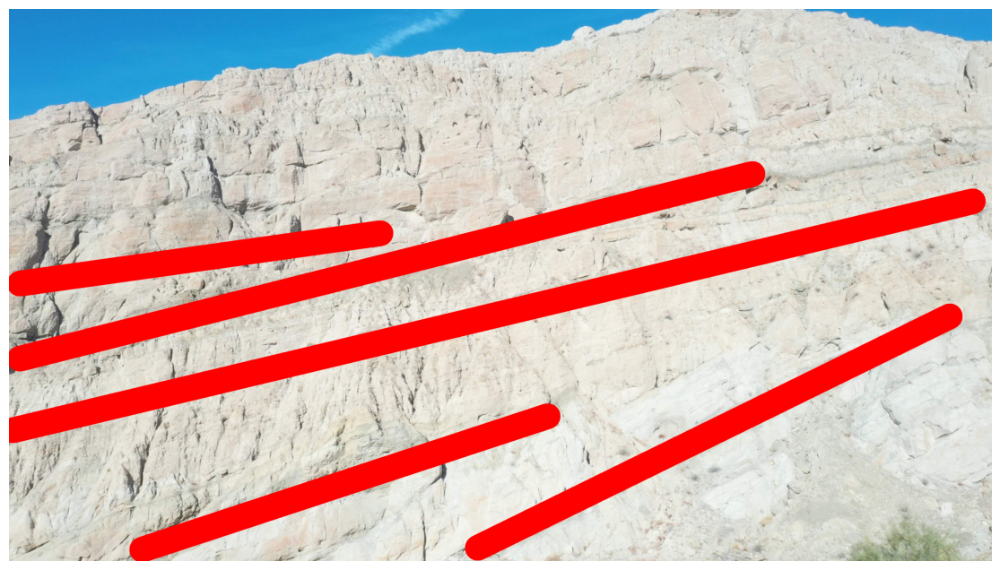

In [ ]:
file_name = "Jan14_0570_frame0.jpg"
image = viz_image(file_name,annot)

**Extracting the image mask:**

In [ ]:
mask = np.zeros((image.shape[0],image.shape[1]), dtype = "uint8")

In [ ]:
mask[(image[:,:,0] == 255) & (image[:,:,1] == 0) & (image[:,:,2] == 0)] = 1

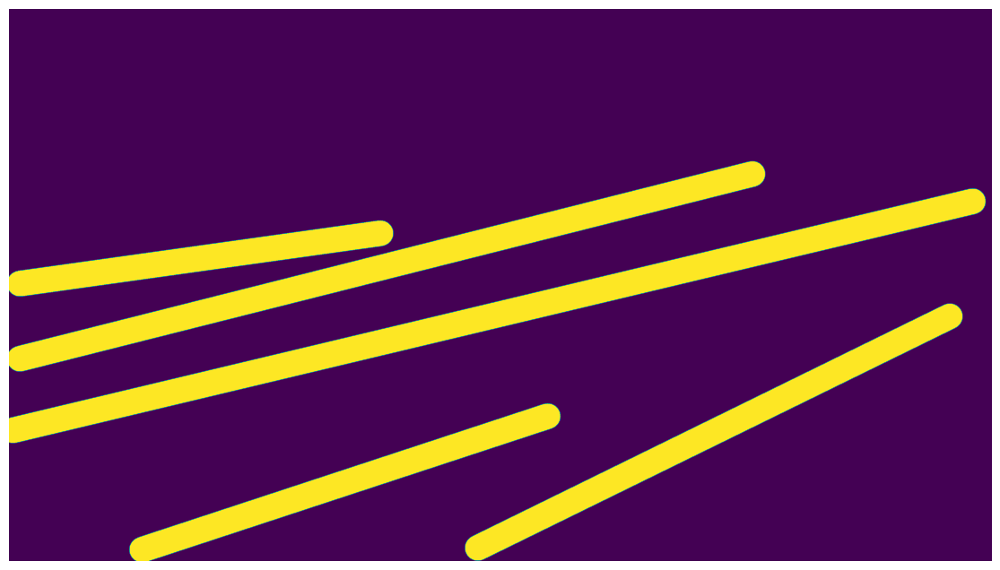

In [ ]:
plt.figure(figsize = (16,8))
plt.imshow(mask)
plt.axis("off");

**We can train a image segementation model now!(Unet)** 
```
problem :  very less data
solution:  extract highly semantic features! (texture based?) 
```

---

## Trying to extract features: 

**Try1 : Gabor filters**

In [ ]:
from PIL import Image, ImageEnhance
import numpy as np
from PIL import ImageFilter
import colorsys
import os
from skimage.filters import gabor, gaussian
from IPython.display import display 
from matplotlib.pyplot import imshow
from pywt import dwt2
import pickle
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
%matplotlib inline


(3840, 2160)


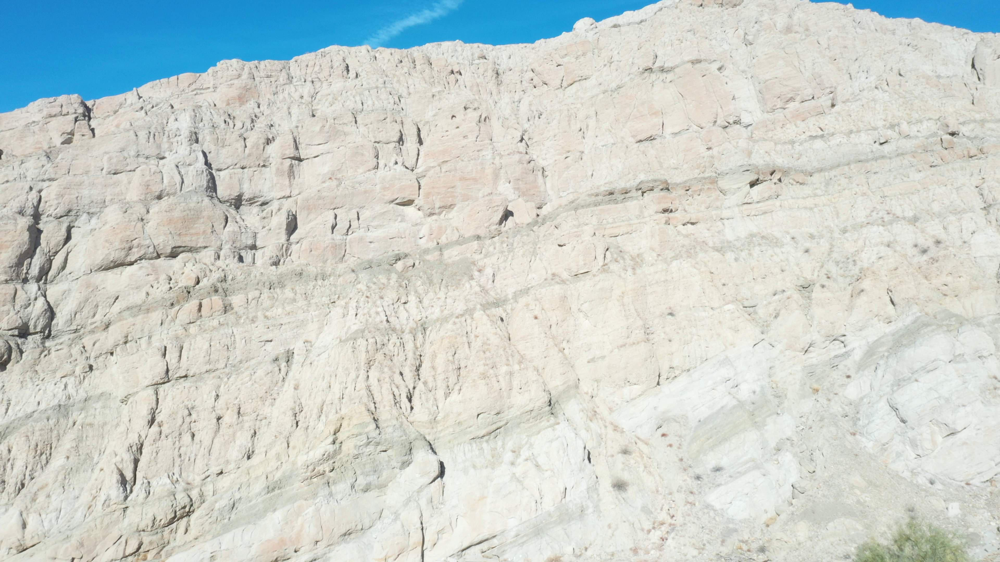

In [ ]:
image1 = "/content/sample_data/Unlabelled/Jan14_0570_frame0.jpg"
image = Image.open(image1).convert('RGB')
image_size = image.size
print(image_size)
display(image)

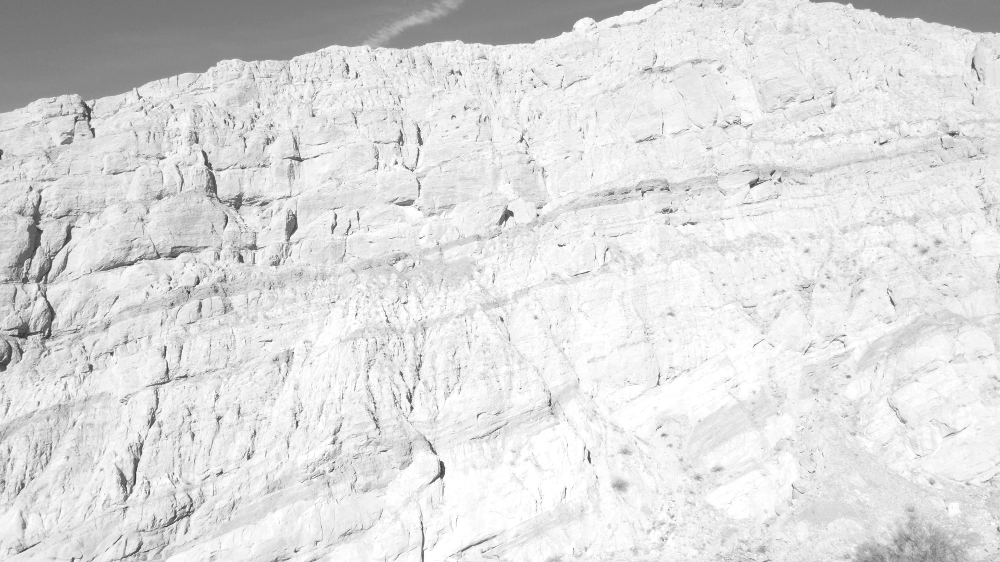

In [ ]:
def enhance_brightness(image):
    """
    :param image: unenhanced image
    :return: Image with enhanced brightness. The new brightness is within the range of [0.3, 1] if the original brightness is greater than 0.1 else it is set to 0.1
    """
    mean_brightness = get_brightness(image)
    a, b = [0.3, 1]
    if mean_brightness<0.1:
        a = 0.1
    min_, max_ = [0, 1]
    new_brightness = (b - a) * (mean_brightness - min_) / (max_ - min_) + a
        
    brightness_factor = new_brightness/mean_brightness
    enhancer = ImageEnhance.Brightness(image)
    enhanced_image = enhancer.enhance(brightness_factor)
    return enhanced_image


def get_brightness(image):
    """
    :param image: unenhanced image
    :return: mean brightness of the image
    """
    brightness = []
    pixel_values = list(image.getdata())
    for values in pixel_values:
        R, G, B = values
        bright = np.sqrt(0.299 * R ** 2 + 0.587 * G ** 2 + 0.114 * B ** 2) / 255
        brightness.append(bright)
    return np.mean(brightness)

converter = ImageEnhance.Color(image)
image = converter.enhance(0.5) #enchance color by a factor of 0.5
image = enhance_brightness(image)
# convert to grayscale
image = image.convert('L')
display(image)

In [ ]:
def get_image_energy(pixels):
    """
    :param pixels: image array
    :return: Energy content of the image
    """
    _, (cH, cV, cD) = dwt2(pixels.T, 'db1')
    energy = (cH ** 2 + cV ** 2 + cD ** 2).sum() / pixels.size
    return energy


def get_energy_density(pixels):
    """
    :param pixels: image array
    :param size: size of the image
    :return: Energy density of the image based on its size
    """
    energy = get_image_energy(pixels)
    energy_density = energy / (pixels.shape[0]*pixels.shape[1])
    return round(energy_density*100,5) # multiplying by 100 because the values are very small

pixels = np.asarray(image, dtype="int32")
energy_density = get_energy_density(pixels)
# get fixed bandwidth using energy density
bandwidth = abs(0.4*energy_density - 0.5)

In [ ]:
def get_magnitude(response):
    """
    :param response: original gabor response in the form: [real_part, imag_part] 
    :return: the magnitude response for the input gabor response
    """
    magnitude = np.array([np.sqrt(response[0][i][j]**2+response[1][i][j]**2)
                        for i in range(len(response[0])) for j in range(len(response[0][i]))])
    return magnitude

magnitude_dict = {}
for theta in np.arange(0, np.pi, np.pi / 6):
    for freq in np.array([1.4142135623730951, 2.414213562373095, 2.8284271247461903, 3.414213562373095]): 
        filt_real, filt_imag = gabor(np.asanyarray(image), frequency=freq, bandwidth=bandwidth, theta=theta)
        # get magnitude response
        magnitude = get_magnitude([filt_real, filt_imag])
        ''' uncomment the lines below to visualize each magnitude response '''
        # im = Image.fromarray(magnitude.reshape(image_size)).convert('L')
        # display(im)
        magnitude_dict[(theta, freq)] = magnitude.reshape(image.size)

KeyboardInterrupt: ignored

In [ ]:
def apply_pca(array):
    """
    :param array: array of shape pXd
    :return: reduced and transformed array of shape dX1
    """
    # apply dimensionality reduction to the input array
    standardized_data = StandardScaler().fit_transform(array)
    pca = PCA(n_components=1)
    pca.fit(standardized_data)
    transformed_data = pca.transform(standardized_data)
    return transformed_data

# apply gaussian smoothing
gabor_mag = []
for key, values in magnitude_dict.items():
    # the value of sigma is chosen to be half of the applied frequency
    sigma = 0.5*key[1]
    smoothed = gaussian(values, sigma = sigma)
    gabor_mag.append(smoothed)
gabor_mag = np.array(gabor_mag)

# reshape so that we can apply PCA
value = gabor_mag.reshape((-1, image_size[0]*image_size[1]))

# get dimensionally reduced image
pcaed = apply_pca(value.T).astype(np.uint8)
result = pcaed.reshape((image_size[0], image_size[1]))
result_im = Image.fromarray(result, mode='L')

In [ ]:
display(result_im)

**Try2: Scratch analysis**

(-0.5, 3839.5, 2159.5, -0.5)

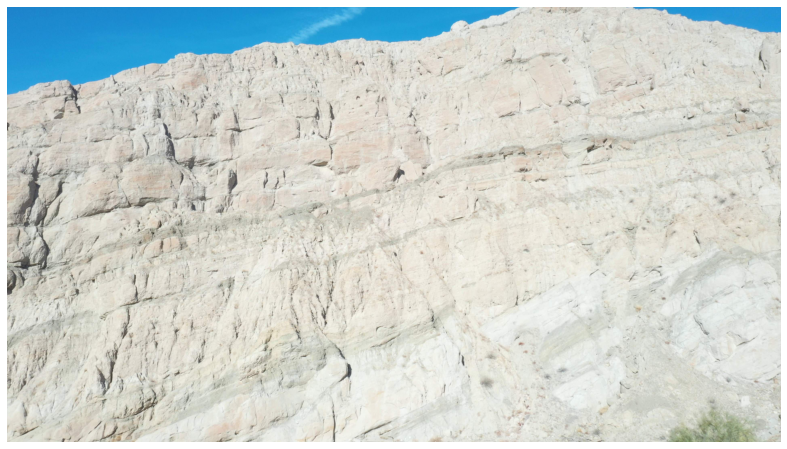

In [ ]:
import matplotlib.pyplot as plt
from skimage import io

import numpy as np
from skimage.filters import threshold_otsu
import cv2

img = io.imread("/content/sample_data/Unlabelled/Jan14_0570_frame0.jpg", as_gray=True)

plt.figure(figsize = (16,8))
plt.imshow(img)
plt.axis("off")



(-0.5, 3839.5, 2159.5, -0.5)

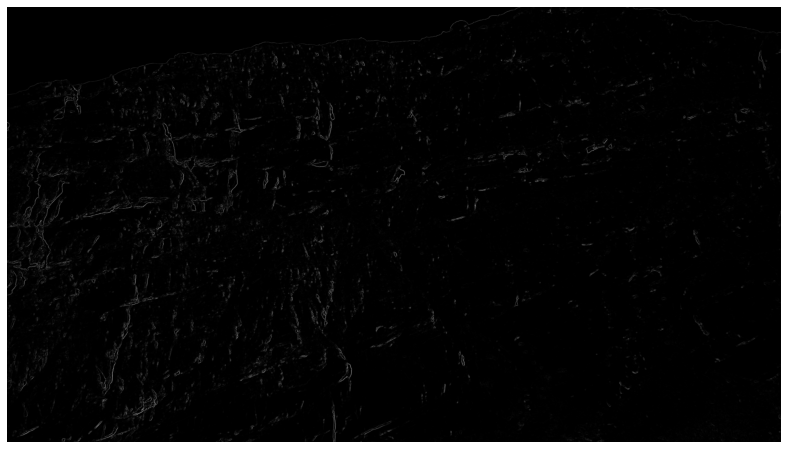

In [ ]:
img = io.imread("/content/sample_data/Unlabelled/Jan14_0570_frame0.jpg", as_gray=True)
##################################################
#Variance - not a great way to quantify texture
from scipy import ndimage 
k=3
img_mean = ndimage.uniform_filter(img, (k, k))
img_sqr_mean = ndimage.uniform_filter(img**2, (k, k))
img_var = img_sqr_mean - img_mean**2
plt.figure(figsize = (16,8))
plt.imshow(img_var, cmap='gray')
plt.axis("off")


(-0.5, 3839.5, 2159.5, -0.5)

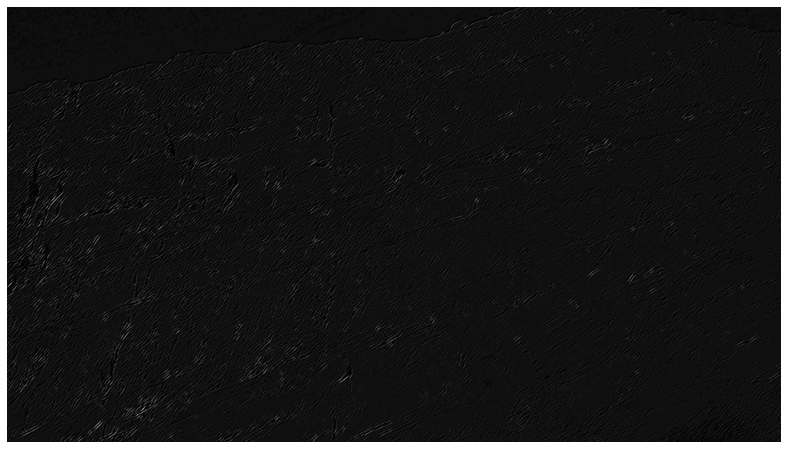

In [ ]:
#######################################################
#GABOR - A great filter for texture but usually efficient
#if we know exact parameters. Good choice for generating features
#for machine learning

ksize=45
theta=np.pi/4
kernel = cv2.getGaborKernel((ksize, ksize), 5.0, theta, 10.0, 0.9, 0, ktype=cv2.CV_32F)
filtered_image = cv2.filter2D(img, cv2.CV_8UC3, kernel)
plt.figure(figsize = (16,8))
plt.imshow(filtered_image, cmap='gray')
plt.axis("off")

<ipython-input-32-7ac274c47f50>:8: UserWarning: Possible precision loss converting image of type float64 to uint8 as required by rank filters. Convert manually using skimage.util.img_as_ubyte to silence this warning.

  entropy_img = entropy(img, disk(3))


(-0.5, 3839.5, 2159.5, -0.5)

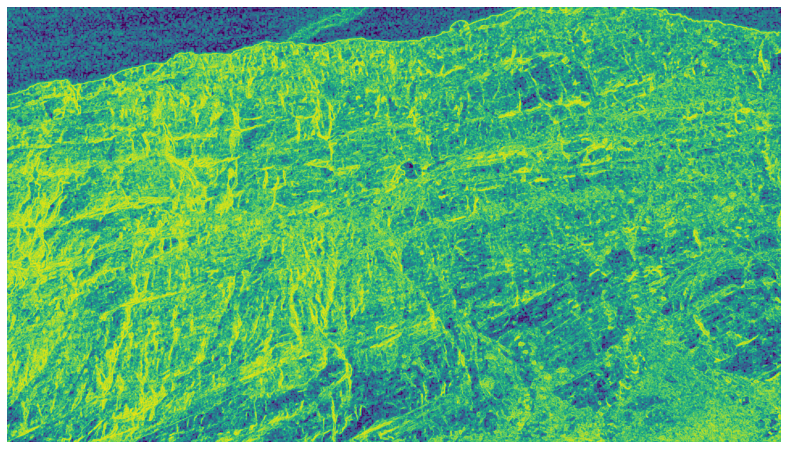

In [ ]:
###########################################################
#Entropy
#Entropy quantifies disorder.
#Since cell region has high variation in pixel values the entropy would be
#higher compared to scratch region
from skimage.filters.rank import entropy
from skimage.morphology import disk
entropy_img = entropy(img, disk(3))
plt.figure(figsize = (16,8))
plt.imshow(entropy_img)
plt.axis("off")

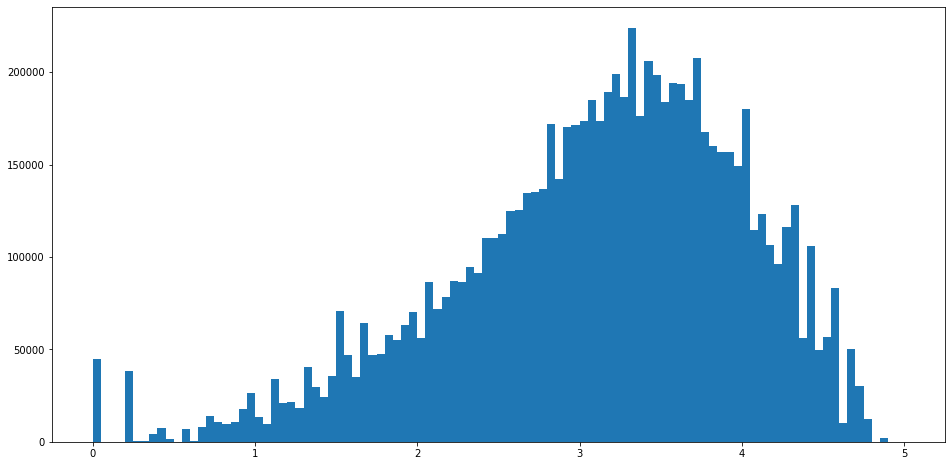

In [ ]:
#Scratch Analysis - single image
#Now let us use otsu to threshold high vs low entropy regions.
plt.figure(figsize = (16,8))
plt.hist(entropy_img.flat, bins=100, range=(0,5));  #.flat returns the flattened numpy array (1D)

Scratched area is:  2895380 Square pixels

Scratched area in sq. microns is:  586314.4500000001 Square pixels


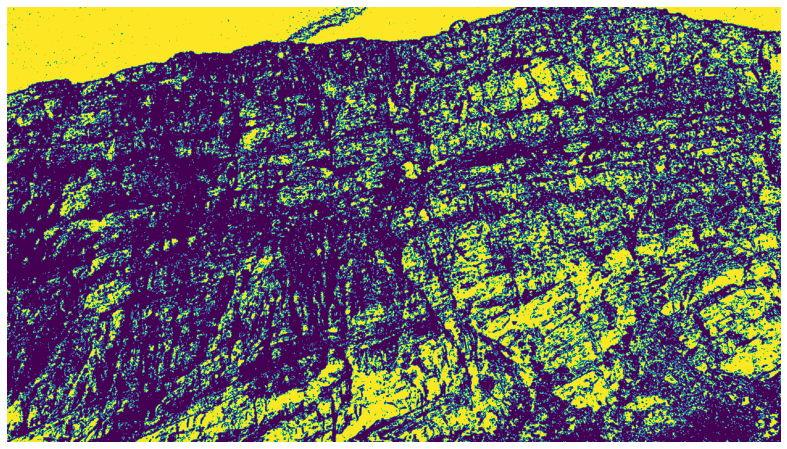

In [ ]:
thresh = threshold_otsu(entropy_img)

#Now let us binarize the entropy image 
binary = entropy_img <= thresh
plt.figure(figsize = (16,8))
plt.imshow(binary)
plt.axis("off")
#Sum all pixels in the scratch region (values =1)
scratch_area = np.sum(binary == 1)
print("Scratched area is: ", scratch_area, "Square pixels")

scale = 0.45 # microns/pixel
print("Scratched area in sq. microns is: ", scratch_area*((scale)**2), "Square pixels")

**Try3: Feature descriptors extraction**

1. Color space

In [ ]:
image_file = "/content/sample_data/Unlabelled/DJI_0026_2.jpg"

(-0.5, 2690.5, 1802.5, -0.5)

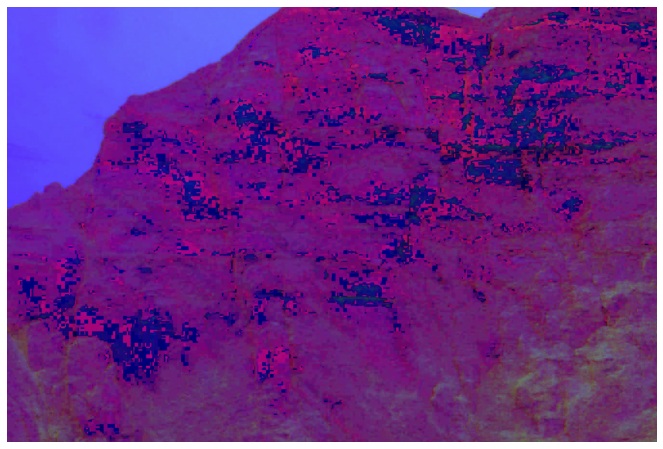

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

image = cv2.imread(image_file)
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
plt.figure(figsize = (16,8))
plt.imshow(hsv_image)
plt.axis("off")

(-0.5, 2690.5, 1802.5, -0.5)

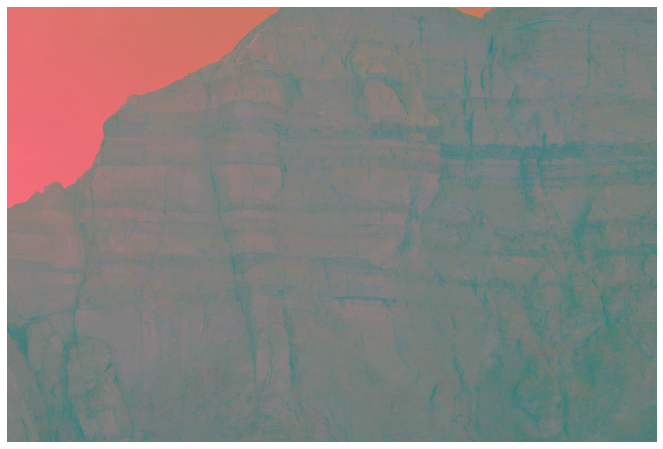

In [ ]:
image = cv2.imread(image_file)
lab_image = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
plt.figure(figsize = (16,8))
plt.imshow(lab_image)
plt.axis("off")

(-0.5, 2690.5, 1802.5, -0.5)

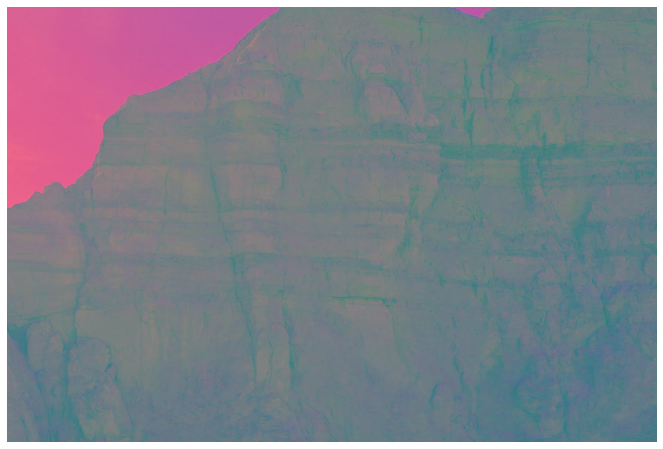

In [ ]:
image = cv2.imread(image_file)
ycrcb_image = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
plt.figure(figsize = (16,8))
plt.imshow(ycrcb_image)
plt.axis("off")

In [ ]:
paths = os.listdir("/content/sample_data/Unlabelled")

In [ ]:
images = []
for path in paths:
  path = "/content/sample_data/Unlabelled/"+file_name
  img = cv2.imread(path)
  img = cv2.resize(img,(4096,2048))
  images.append(img)


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import plotly.figure_factory as ff

# Check the distribution of red values 
red_values = []
for i in range(len(images)):
  red_value = np.mean(images[i][:, :, 0])
  red_values.append(red_value)

# Check the distribution of green values 
green_values = []
for i in range(len(images)):
  green_value = np.mean(images[i][:, :, 1])
  green_values.append(green_value)

# Check the distribution of blue values 
blue_values = []
for i in range(len(images)):
  blue_value = np.mean(images[i][:, :, 2])
  blue_values.append(blue_value)
  
# Plotting the histogram
fig = ff.create_distplot([red_values, green_values, blue_values], group_labels=["R", "G", "B"], colors=['red', 'green', 'blue'])
fig.update_layout(showlegend=True, template="simple_white")
fig.update_layout(title_text='Distribution of channel values across images in RGB')
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig.data[2].marker.line.color = 'rgb(0, 0, 0)'
fig.data[2].marker.line.width = 0.5
fig

**Here all the channel means are almost similiar!**

2. Shape?

3. Texture space:

In [ ]:
image_spot = cv2.imread(image_file)
gray = cv2.cvtColor(image_spot, cv2.COLOR_BGR2GRAY)

# Find the GLCM
import skimage.feature as feature

# Param:
# source image
# List of pixel pair distance offsets - here 1 in each direction
# List of pixel pair angles in radians
graycom = feature.graycomatrix(gray, [1], [0, np.pi/4, np.pi/2, 3*np.pi/4], levels=256)

# Find the GLCM properties
contrast = feature.graycoprops(graycom, 'contrast')
dissimilarity = feature.graycoprops(graycom, 'dissimilarity')
homogeneity = feature.graycoprops(graycom, 'homogeneity')
energy = feature.graycoprops(graycom, 'energy')
correlation = feature.graycoprops(graycom, 'correlation')
ASM = feature.graycoprops(graycom, 'ASM')

print("Contrast: {}".format(contrast))
print("Dissimilarity: {}".format(dissimilarity))
print("Homogeneity: {}".format(homogeneity))
print("Energy: {}".format(energy))
print("Correlation: {}".format(correlation))
print("ASM: {}".format(ASM))

Contrast: [[15.56160736 30.89846144 18.41904697 28.88905285]]

Dissimilarity: [[2.45540271 3.56998213 2.73801953 3.54791681]]

Homogeneity: [[0.41349271 0.32070532 0.3833657  0.32055562]]

Energy: [[0.04282169 0.03552732 0.040247   0.03551634]]

Correlation: [[0.99364933 0.98738629 0.99248435 0.98820445]]

ASM: [[0.0018337  0.00126219 0.00161982 0.00126141]]


In [ ]:
contrast = contrast.flatten()
dissimilarity = dissimilarity.flatten()
homogeneity = homogeneity.flatten()
energy = energy.flatten()
correlation = correlation.flatten()
ASM = ASM.flatten()

features = np.concatenate((contrast, dissimilarity, homogeneity, energy, correlation, ASM), axis=0) 
print(features)

[1.55616074e+01 3.08984614e+01 1.84190470e+01 2.88890528e+01

 2.45540271e+00 3.56998213e+00 2.73801953e+00 3.54791681e+00

 4.13492709e-01 3.20705325e-01 3.83365695e-01 3.20555618e-01

 4.28216885e-02 3.55273228e-02 4.02470018e-02 3.55163437e-02

 9.93649326e-01 9.87386292e-01 9.92484352e-01 9.88204454e-01

 1.83369700e-03 1.26219066e-03 1.61982115e-03 1.26141067e-03]


Need to explore this more..

Histogram of Local Binary Pattern value: [0.03944642 0.03351221 0.01195209 0.00601252 0.00413737 0.00334613

 0.00279933 0.00283973 0.00278614 0.0030786  0.00321773 0.00409739

 0.00407204 0.00519243 0.00344218 0.00374701 0.0029939  0.00373753

 0.00332552 0.0049216  0.00603602 0.01036301 0.0201483  0.03928029

 0.05722038 0.71829415]


(-0.5, 2690.5, 1802.5, -0.5)

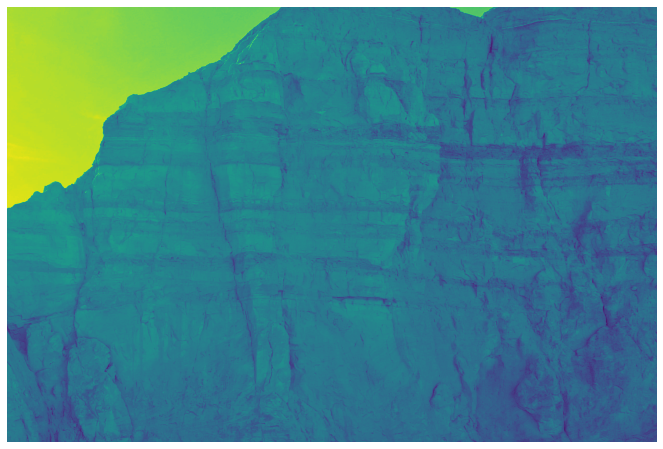

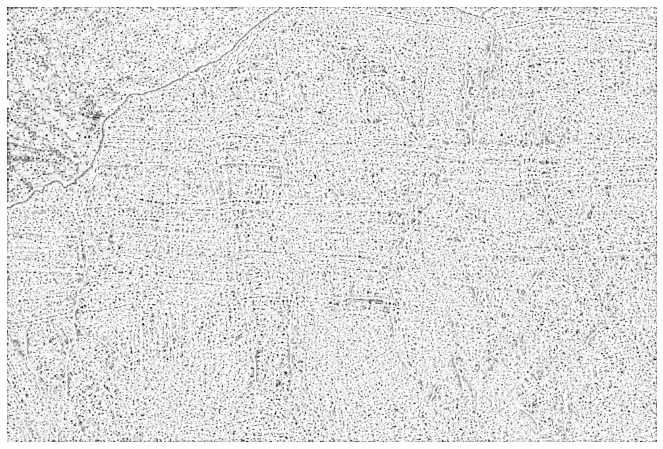

In [ ]:
class LocalBinaryPatterns:
  def __init__(self, numPoints, radius):
    self.numPoints = numPoints
    self.radius = radius

  def describe(self, image, eps = 1e-7):
    lbp = feature.local_binary_pattern(image, self.numPoints, self.radius, method="uniform")
    (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, self.numPoints+3), range=(0, self.numPoints + 2))

    # Normalize the histogram
    hist = hist.astype('float')
    hist /= (hist.sum() + eps)

    return hist, lbp

image = cv2.imread(image_file)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
desc = LocalBinaryPatterns(24, 8)
hist, lbp = desc.describe(gray)
print("Histogram of Local Binary Pattern value: {}".format(hist))

plt.figure(figsize = (16,8))
plt.imshow(gray)
plt.axis("off")

plt.figure(figsize = (16,8))
plt.imshow(lbp, cmap = "gray")
plt.axis("off")

In [ ]:
contrast = contrast.flatten()
dissimilarity = dissimilarity.flatten()
homogeneity = homogeneity.flatten()
energy = energy.flatten()
correlation = correlation.flatten()
ASM = ASM.flatten()
hist = hist.flatten()

features = np.concatenate((contrast, dissimilarity, homogeneity, energy, correlation, ASM, hist), axis=0) 
print(features)

[1.55616074e+01 3.08984614e+01 1.84190470e+01 2.88890528e+01

 2.45540271e+00 3.56998213e+00 2.73801953e+00 3.54791681e+00

 4.13492709e-01 3.20705325e-01 3.83365695e-01 3.20555618e-01

 4.28216885e-02 3.55273228e-02 4.02470018e-02 3.55163437e-02

 9.93649326e-01 9.87386292e-01 9.92484352e-01 9.88204454e-01

 1.83369700e-03 1.26219066e-03 1.61982115e-03 1.26141067e-03

 3.94464158e-02 3.35122127e-02 1.19520853e-02 6.01252341e-03

 4.13737128e-03 3.34613045e-03 2.79933131e-03 2.83972808e-03

 2.78614053e-03 3.07860490e-03 3.21772643e-03 4.09738672e-03

 4.07203569e-03 5.19242775e-03 3.44217584e-03 3.74700657e-03

 2.99389535e-03 3.73752569e-03 3.32551986e-03 4.92160450e-03

 6.03601949e-03 1.03630083e-02 2.01483015e-02 3.92802944e-02

 5.72203765e-02 7.18294152e-01]


----

**Try Last: Unet works!**

(credit: Shivay Nagpal)

**Helper Functions**

In [ ]:
#function to load the image:
def load_image(filename):
  img = cv2.imread("/kaggle/input/rockline/Unlabelled/" + filename)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

#function to get the annotations:
def get_annot(filename,shape,data = annot):
  #load image:
  img = load_image(filename)
  annot_img = load_image(filename)

  #read the annotations:
  annotations = []
  for i in range(data.shape[0]):
    if data.loc[i,"Filename"] == filename:
      annotations.extend(data.loc[i,"new_cords"])
  
  #draw the annotations using cv2 line
  for dic in annotations:
      cv2.line(annot_img,(dic["x1"],dic["y1"]),(dic["x2"],dic["y2"]),color = (255,0,0),thickness = 100)
  
  #return the output image
  return img,annot_img


#function to get the mask:
def get_mask(filename,shape,data = annot):
  img,annot_img = get_annot(filename,shape)
  mask = np.zeros((img.shape[0],img.shape[1]), dtype = "uint8")
  mask[(annot_img[:,:,0] == 255) & (annot_img[:,:,1] == 0) & (annot_img[:,:,2] == 0)] = 1

  #resizing the images to required shape
  img = cv2.resize(img,shape)
  annot_img = cv2.resize(annot_img,shape)
  mask = cv2.resize(mask,shape)

  return img,annot_img,mask

**Visualizing**

In [ ]:
filename = "_0566_frame2115.jpg"
shape    = (224,224)

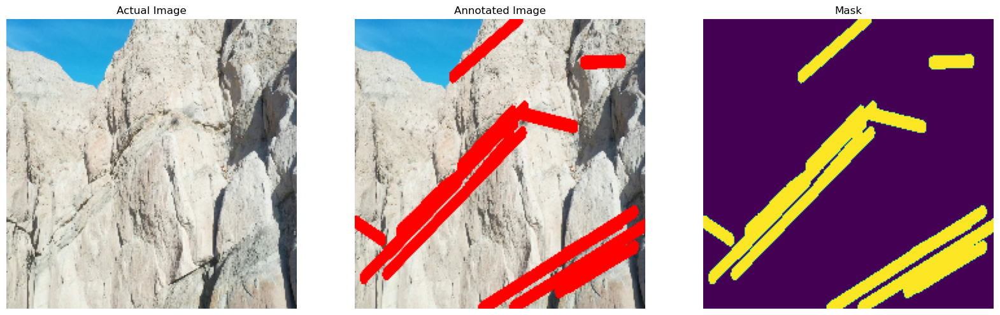

In [ ]:
img,annot_img,mask = get_mask(filename,shape)

fig = plt.figure(figsize = (20,10))

ax = plt.subplot(1,3,1)
ax.imshow(img)
ax.set_title("Actual Image")
plt.axis("off")

ax = plt.subplot(1,3,2)
ax.imshow(annot_img)
ax.set_title("Annotated Image")
plt.axis("off")

ax = plt.subplot(1,3,3)
ax.imshow(mask)
ax.set_title("Mask")
plt.axis("off");

**Dataset**

In [ ]:
import os
paths = os.listdir("/kaggle/input/rockline/Unlabelled")

In [ ]:
test_size = 5
train_size = len(paths) - test_size
shape = (224,224)


#initializing train data:
train_input = np.zeros((train_size , shape[0] ,shape[1] , 3),dtype = "uint8")
train_annot = np.zeros((train_size , shape[0] ,shape[1] , 3),dtype = "uint8")
train_mask  = np.zeros((train_size , shape[0] ,shape[1] ),dtype = "uint8")

#initializing test data:
test_input = np.zeros((test_size , shape[0] ,shape[1] , 3),dtype = "uint8")
test_annot = np.zeros((test_size , shape[0] ,shape[1] , 3),dtype = "uint8")
test_mask  = np.zeros((test_size , shape[0] ,shape[1] ),dtype = "uint8")

In [ ]:
#train data:
for i in range(train_size):
  train_input[i],train_annot[i],train_mask[i] = get_mask(paths[i],shape)

#test data:
for i in range(train_size,train_size+test_size):
  test_input[i-train_size],test_annot[i-train_size],test_mask[i-train_size] = get_mask(paths[i],shape)


In [ ]:
#one hot encoding the output:
from tensorflow.keras.utils import to_categorical
train_output = to_categorical(train_mask , 2)
test_output  = to_categorical(test_mask  , 2)

In [ ]:
def viz(data,n,name = "Image:"):
  fig = plt.figure(figsize = (20,10))
  for i in range(n):
    ax = plt.subplot(1,n,i+1)
    ax.imshow(data[i])
    ax.set_title(name+str(i))
    plt.axis("off")

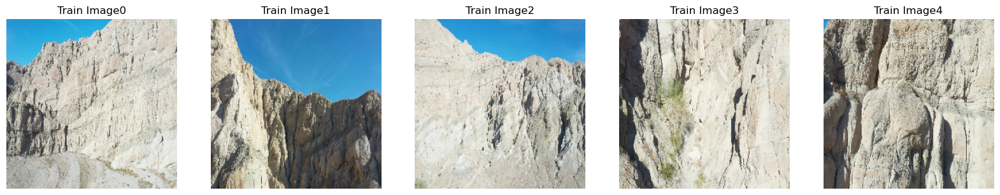

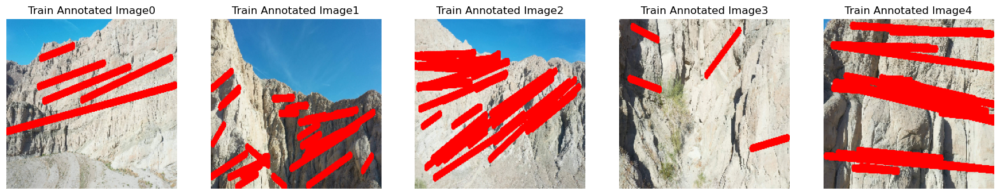

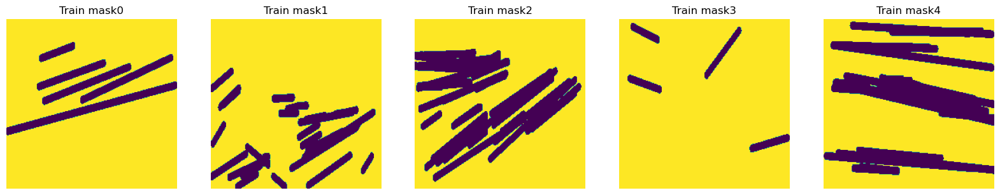

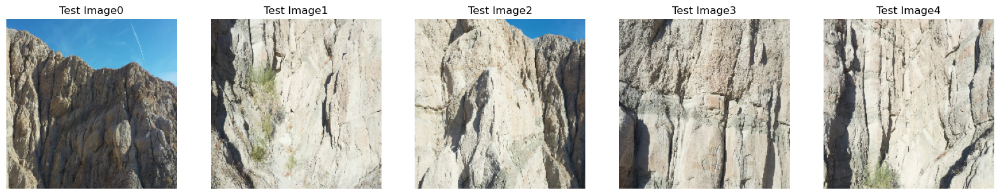

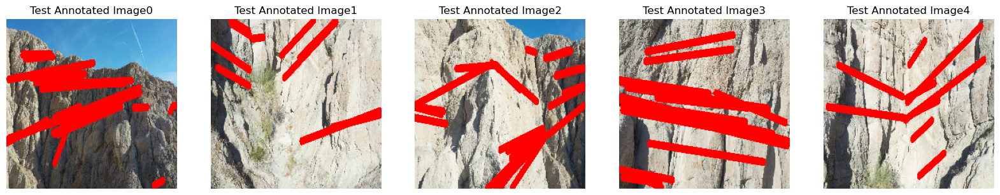

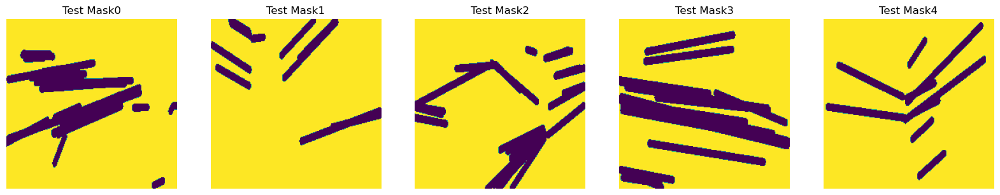

In [ ]:
viz(train_input,5,"Train Image")
viz(train_annot,5,"Train Annotated Image")
viz(train_output[:,:,:,0],5,"Train mask")

viz(test_input,5,"Test Image")
viz(test_annot,5,"Test Annotated Image")
viz(test_output[:,:,:,0],5,"Test Mask")

**Model**

```
Model     : Unet (based on resnet18)
Weights   : Imagenet
Loss      : Jaccard Loss  (chose this based on personal experience)
Metrics   : IOU , precision 
activation: softmax
```

In [ ]:
!pip install -U -q segmentation-models

# importing segementations models using keras framework:
os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm

Segmentation Models: using `tf.keras` framework.


In [ ]:
#loading the model
model = sm.Unet(
    'resnet18',
    input_shape =(224,224,3),
    classes=2, 
    encoder_freeze=True,
    activation='softmax',
    encoder_weights='imagenet'

)

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 bn_data (BatchNormalization)   (None, 224, 224, 3)  9           ['data[0][0]']                   
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['bn_data[0][0]']                
                                                                                                  
 conv0 (Conv2D)                 (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']   

In [ ]:
#compiling the model:
model.compile(
    optimizer ="adam" , 
    loss = sm.losses.bce_jaccard_loss , 
    metrics = [sm.metrics.iou_score, sm.metrics.precision]
    )

In [ ]:
history = model.fit(train_input , train_output,batch_size = 4 , epochs = 100, verbose = 1)

Epoch 1/100
33/33 [==============================] - 16s 79ms/step - loss: 1.1445 - iou_score: 0.4234 - precision: 0.5665
Epoch 2/100
33/33 [==============================] - 2s 47ms/step - loss: 0.9072 - iou_score: 0.5232 - precision: 0.6734
Epoch 3/100
33/33 [==============================] - 2s 47ms/step - loss: 0.8486 - iou_score: 0.5559 - precision: 0.7057
Epoch 4/100
33/33 [==============================] - 2s 47ms/step - loss: 0.7837 - iou_score: 0.5905 - precision: 0.7291
Epoch 5/100
33/33 [==============================] - 2s 47ms/step - loss: 0.7631 - iou_score: 0.6007 - precision: 0.7391
Epoch 6/100
33/33 [==============================] - 2s 50ms/step - loss: 0.7357 - iou_score: 0.6191 - precision: 0.7612
Epoch 7/100
33/33 [==============================] - 2s 48ms/step - loss: 0.7023 - iou_score: 0.6365 - precision: 0.7690
Epoch 8/100
33/33 [==============================] - 2s 48ms/step - loss: 0.6716 - iou_score: 0.6524 - precision: 0.7805
Epoch 9/100
33/33 [============

In [ ]:
#predicted output:
pred = model.predict(test_input)
pred_mask = np.argmax(pred,axis = 3)

1/1 [==============================] - 0s 497ms/step


**Visualizing the output**

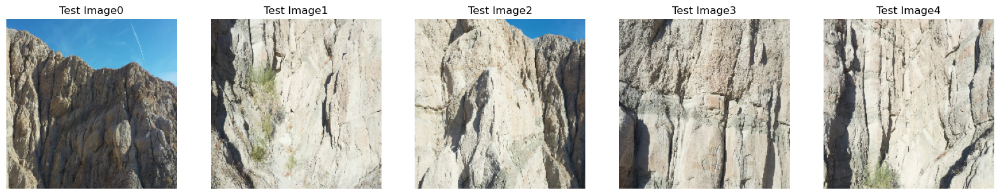

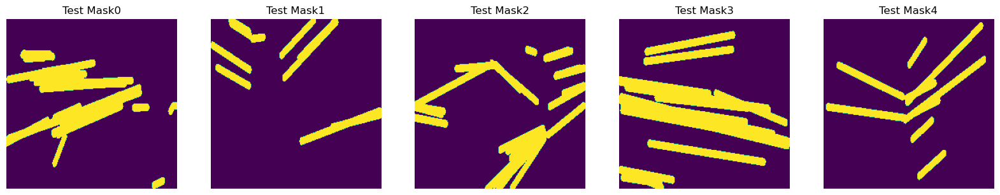

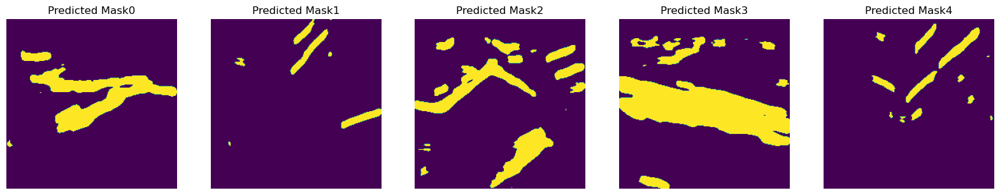

In [ ]:
viz(test_input,5,"Test Image")
viz(test_output[:,:,:,1],5,"Test Mask")
viz(pred_mask,5,"Predicted Mask")

**Tuning**

Epoch 1/100
33/33 [==============================] - 13s 49ms/step - loss: 0.9559 - iou_score: 0.4428 - precision: 0.5755
Epoch 2/100
33/33 [==============================] - 2s 46ms/step - loss: 0.8000 - iou_score: 0.5129 - precision: 0.6581
Epoch 3/100
33/33 [==============================] - 2s 47ms/step - loss: 0.7139 - iou_score: 0.5585 - precision: 0.7024
Epoch 4/100
33/33 [==============================] - 2s 47ms/step - loss: 0.6676 - iou_score: 0.5857 - precision: 0.7274
Epoch 5/100
33/33 [==============================] - 2s 46ms/step - loss: 0.6339 - iou_score: 0.6016 - precision: 0.7450
Epoch 6/100
33/33 [==============================] - 2s 46ms/step - loss: 0.5930 - iou_score: 0.6255 - precision: 0.7573
Epoch 7/100
33/33 [==============================] - 2s 47ms/step - loss: 0.5918 - iou_score: 0.6272 - precision: 0.7676
Epoch 8/100
33/33 [==============================] - 2s 47ms/step - loss: 0.5595 - iou_score: 0.6435 - precision: 0.7725
Epoch 9/100
33/33 [============

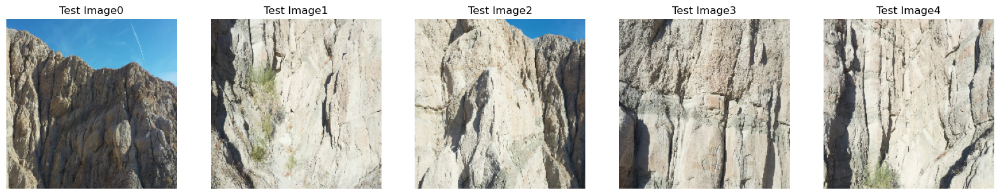

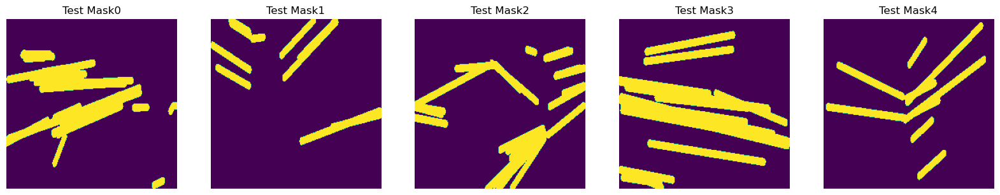

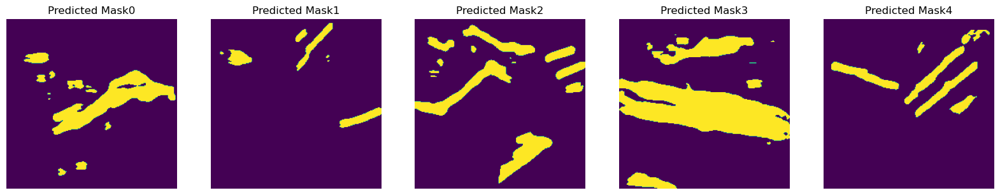

In [ ]:
#loading the model
model2 = sm.Unet(
    'resnet18',
    input_shape =(224,224,3),
    classes=2, 
    encoder_freeze=True,
    activation='softmax',
    encoder_weights='imagenet'

)

#compiling the model:
model2.compile(
    optimizer ="adam" , 
    loss = sm.losses.bce_dice_loss , 
    metrics = [sm.metrics.iou_score, sm.metrics.precision]
    )

history2 = model2.fit(train_input , train_output,batch_size = 4 , epochs = 100, verbose = 1)

#predicted output:
pred2 = model2.predict(test_input)
pred_mask2 = np.argmax(pred2,axis = 3)

#output
viz(test_input,5,"Test Image")
viz(test_output[:,:,:,1],5,"Test Mask")
viz(pred_mask2,5,"Predicted Mask")

Epoch 1/100
33/33 [==============================] - 14s 49ms/step - loss: 0.5719 - iou_score: 0.3802 - precision: 0.5318
Epoch 2/100
33/33 [==============================] - 1s 45ms/step - loss: 0.4948 - iou_score: 0.4454 - precision: 0.5847
Epoch 3/100
33/33 [==============================] - 1s 45ms/step - loss: 0.4539 - iou_score: 0.4896 - precision: 0.6254
Epoch 4/100
33/33 [==============================] - 1s 45ms/step - loss: 0.4318 - iou_score: 0.5089 - precision: 0.6440
Epoch 5/100
33/33 [==============================] - 1s 45ms/step - loss: 0.4120 - iou_score: 0.5324 - precision: 0.6663
Epoch 6/100
33/33 [==============================] - 2s 46ms/step - loss: 0.3834 - iou_score: 0.5605 - precision: 0.6906
Epoch 7/100
33/33 [==============================] - 2s 47ms/step - loss: 0.3720 - iou_score: 0.5736 - precision: 0.7048
Epoch 8/100
33/33 [==============================] - 2s 49ms/step - loss: 0.3586 - iou_score: 0.5838 - precision: 0.7132
Epoch 9/100
33/33 [============

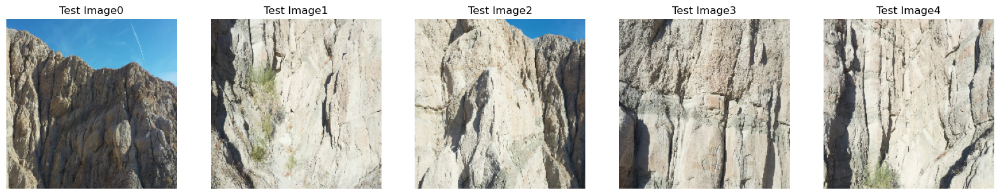

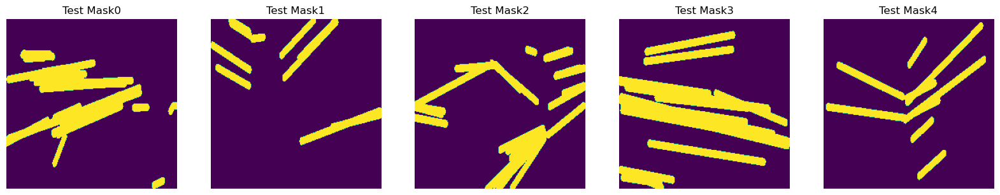

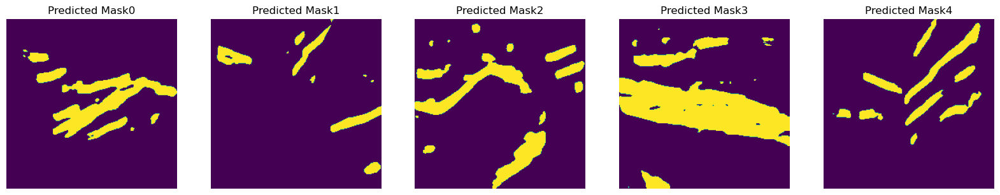

In [ ]:
#loading the model
model3 = sm.Unet(
    'resnet18',
    input_shape =(224,224,3),
    classes=2, 
    encoder_freeze=True,
    activation='softmax',
    encoder_weights='imagenet'

)

#compiling the model:
model3.compile(
    optimizer ="adam" , 
    loss = sm.losses.binary_focal_dice_loss , 
    metrics = [sm.metrics.iou_score, sm.metrics.precision]
    )

history3 = model3.fit(train_input , train_output,batch_size = 4 , epochs = 100, verbose = 1)

#predicted output:
pred3 = model3.predict(test_input)
pred_mask3 = np.argmax(pred3,axis = 3)

#output
viz(test_input,5,"Test Image")
viz(test_output[:,:,:,1],5,"Test Mask")
viz(pred_mask3,5,"Predicted Mask")

**Comparing between different models:**

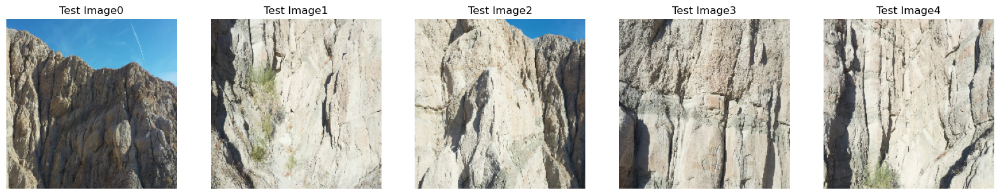

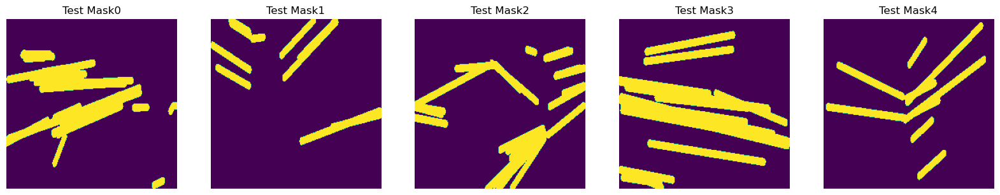

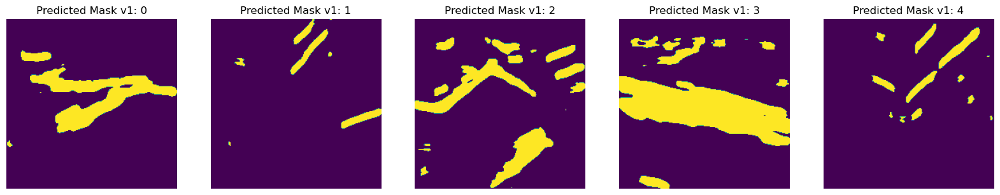

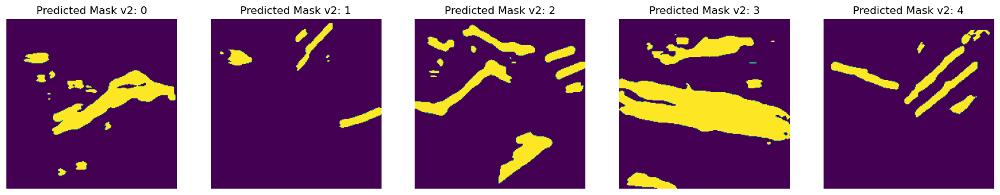

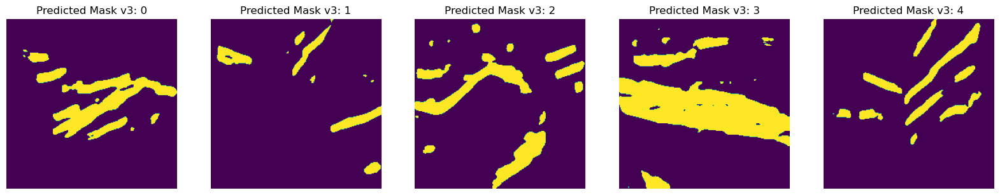

In [ ]:
viz(test_input,5,"Test Image")
viz(test_output[:,:,:,1],5,"Test Mask")
viz(pred_mask,5,"Predicted Mask v1: ")
viz(pred_mask2,5,"Predicted Mask v2: ")
viz(pred_mask3,5,"Predicted Mask v3: ")

---
## Conclusion:
---
### Done:
**a. Cleaning data:** 
<p>
From the given annotations, I emperically observed that most of the miscalssified annotations were of line with very high slope. So I set a higher threshold of 60 degrees of slope and removed others.
</p>

**b. Feature Extraction:**
<p>
Explored colorspace and texture space to try and extract relevant high semantic features. I have identified few methods with which we can do the same.
</p>

**c. Semantic Segmentation:**
<p>
Using the cleaned annotations, created maps and trained a Unet model to predict the bedrock line. 
</p>

---

### Todo:
1. Making use of the features extracted 
2. Further cleaning of annotations and data
3. Exploring other methods for feature extraction.

---